<a href="https://colab.research.google.com/github/xeonqq/FourierFeatureSiren/blob/main/ffn_vs_siren_and_combined.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fourier Feature Network(FFN) VS Siren, can we combine them?

This is a colab to compare the performace of [Fourier Feature Network(FFN)](https://bmild.github.io/fourfeat/) and Siren MLP, proposed in work [Implicit Neural Activations with Periodic Activation Functions](https://vsitzmann.github.io/siren). In terms of accuracy in image fitting.

In the end, a combined version of FFN and Siren (FFNSiren) is presented, which shows the best performace.


* The Siren implementation is a copy-paste from the original implementation from the author

* FFN implementation is a pytorch port from the original jax implemenation from the author. (But removing the last sigmoid layer from the original network) 

In [1]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import numpy as np
import skimage
import matplotlib.pyplot as plt

import time
device = 'cuda' if torch.cuda.is_available() else 'cpu'

def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

In [2]:
print(device)

cuda


In [3]:
torch.manual_seed(0)

Now, we code up the sine layer, which will be the basic building block of SIREN. This is a much more concise implementation than the one in the main code, as here, we aren't concerned with the baseline comparisons.

In [4]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first
        
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))
    
    def forward_with_intermediate(self, input): 
        # For visualization of activation distributions
        intermediate = self.omega_0 * self.linear(input)
        return torch.sin(intermediate), intermediate
    
    
class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False, 
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()
        
        self.net = []
        self.net.append(SineLayer(in_features, hidden_features, 
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features, 
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)
                
            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features, 
                                      is_first=False, omega_0=hidden_omega_0))
        
        self.net = nn.Sequential(*self.net)
    
    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        return output, coords        

    def forward_with_activations(self, coords, retain_grad=False):
        '''Returns not only model output, but also intermediate activations.
        Only used for visualizing activations later!'''
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        for i, layer in enumerate(self.net):
            if isinstance(layer, SineLayer):
                x, intermed = layer.forward_with_intermediate(x)
                
                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()
                    
                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                activation_count += 1
            else: 
                x = layer(x)
                
                if retain_grad:
                    x.retain_grad()
                    
            activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
            activation_count += 1

        return activations

And finally, differential operators that allow us to leverage autograd to compute gradients, the laplacian, etc.

In [5]:
def laplace(y, x):
    grad = gradient(y, x)
    return divergence(grad, x)


def divergence(y, x):
    div = 0.
    for i in range(y.shape[-1]):
        div += torch.autograd.grad(y[..., i], x, torch.ones_like(y[..., i]), create_graph=True)[0][..., i:i+1]
    return div


def gradient(y, x, grad_outputs=None):
    if grad_outputs is None:
        grad_outputs = torch.ones_like(y)
    grad = torch.autograd.grad(y, [x], grad_outputs=grad_outputs, create_graph=True)[0]
    return grad

# Experiments

For the image fitting and poisson experiments, we'll use the classic cameraman image.

In [6]:
def get_cameraman_tensor(sidelength):
    img = Image.fromarray(skimage.data.camera())  
    transform = Compose([
        Resize(sidelength),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

In [7]:

img=get_cameraman_tensor(256)
img.shape

torch.Size([1, 256, 256])

<a id='section_1'></a>
## Fitting an image

First, let's simply fit that image!

We seek to parameterize a greyscale image $f(x)$ with pixel coordinates $x$ with a SIREN $\Phi(x)$.

That is we seek the function $\Phi$ such that:
$\mathcal{L}=\int_{\Omega} \lVert \Phi(\mathbf{x}) - f(\mathbf{x}) \rVert\mathrm{d}\mathbf{x}$
 is minimized, in which $\Omega$ is the domain of the image. 
 
We write a little datast that does nothing except calculating per-pixel coordinates:

In [8]:
class ImageFitting(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)
        self.pixels = img.permute(1, 2, 0).view(-1, 1)
        self.coords = get_mgrid(sidelength, 2)

    def __len__(self):
        return 1

    def __getitem__(self, idx):    
        if idx > 0: raise IndexError
            
        return self.coords, self.pixels

In [9]:
img = get_cameraman_tensor(256)
pixels = img.permute(1, 2, 0).view(-1, 1)


In [10]:
cameraman = ImageFitting(256)
dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Let's instantiate the dataset and our Siren. As pixel coordinates are 2D, the siren has 2 input features, and since the image is grayscale, it has one output channel.

In [11]:


img_siren = Siren(in_features=2, out_features=1, hidden_features=256, 
                  hidden_layers=4, outermost_linear=True)
img_siren.to(device)

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (5): Linear(in_features=256, out_features=1, bias=True)
  )
)

In [12]:
print(sum(p.numel() for p in img_siren.parameters())/1e6, 'M parameters')

0.264193 M parameters


In [13]:
print(f"total pixels {256*256/1e6}")

total pixels 0.065536


In [14]:
def train(model, model_name, dataloader, total_steps, steps_til_summary, plot_gradient=False):
  # plot_gradient consumes way more memory
  
  optim = torch.optim.Adam(lr=1e-4, params=model.parameters())

  model_input, ground_truth = next(iter(dataloader))
  model_input, ground_truth = model_input.to(device), ground_truth.to(device)

  losses = []
  images = []
  for step in range(total_steps):
      model_output, coords = model(model_input)    
      loss = ((model_output - ground_truth)**2).mean()
      losses.append(loss.item())
      if not step % steps_til_summary or (step==total_steps-1):
          print("Step %d, Total loss %0.6f" % (step, loss))
          image =model_output.cpu().view(256,256).detach().numpy()
          images.append(image)
          if plot_gradient:
            img_grad = gradient(model_output, coords)
            img_laplacian = laplace(model_output, coords)
            fig, axes = plt.subplots(1,3, figsize=(18,6))
            axes[0].imshow(image)
            axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
            axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
          else:
            plt.imshow(image)
          plt.show()

      optim.zero_grad()
      loss.backward()
      optim.step()
  torch.cuda.empty_cache()

  return losses, images

We now fit Siren in a simple training loop. Within only hundreds of iterations, the image and its gradients are approximated well.

In [15]:
losses={}
outputs={}
total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

Fourier Feature

In [16]:
def input_mapping(x, B):
  if B is None:
    return x
  else:
    x_proj = (2.*np.pi*x) @ B.T
    embedding = torch.cat([torch.sin(x_proj), torch.cos(x_proj)], axis=-1)
    return embedding

In [17]:
class FFN(nn.Module):
    def __init__(self, in_features, out_features, hidden_dim, n_hidden_layers,trainable_B=False, embedding_dim=256, gaussian_scale=10):
        super().__init__()
        if trainable_B:
          B = torch.randn((embedding_dim,in_features),requires_grad=True)*gaussian_scale
          self.register_parameter(name='B', param=torch.nn.Parameter(B))
        else:
          self.register_buffer("B", torch.randn((embedding_dim,in_features))*gaussian_scale)
        layers = []
        layers.append(nn.Linear(embedding_dim*2, hidden_dim))
        layers.append(nn.ReLU())
        for _ in range(n_hidden_layers):
            layers.append(nn.Linear(hidden_dim, hidden_dim))
            layers.append(nn.ReLU())
        layers.append(nn.Linear(hidden_dim, out_features))
        #layers.append(nn.Sigmoid())

        self.mlp = nn.Sequential(*layers)

    def forward(self, coords): 
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        embedding = input_mapping(coords, self.B)
        x=self.mlp(embedding)
        return x, coords
torch.cuda.empty_cache()

ffn = FFN(2, 1, 256, 2,False)
ffn.to(device)
print(sum(p.numel() for p in ffn.parameters())/1e6, 'M parameters')

0.263169 M parameters


In [18]:
print( [p.shape for p in ffn.parameters()])

[torch.Size([256, 512]), torch.Size([256]), torch.Size([256, 256]), torch.Size([256]), torch.Size([256, 256]), torch.Size([256]), torch.Size([1, 256]), torch.Size([1])]


In [19]:
class FFSiren(nn.Module):
    def __init__(self, in_features, out_features, hidden_dim, n_hidden_layers, embedding_dim=256, gaussian_scale=10):
        super().__init__()
        self.register_buffer("B", torch.randn((embedding_dim,in_features))*gaussian_scale)
        self.siren = Siren(in_features=embedding_dim*2, out_features=out_features, hidden_features=hidden_dim, 
                  hidden_layers=n_hidden_layers, outermost_linear=True)

    def forward(self, coords): 
        embedding = input_mapping(coords, self.B)
        return self.siren(embedding)

ffsiren = FFSiren(2, 1, 256, 2)
ffsiren.to(device)
print(sum(p.numel() for p in ffsiren.parameters())/1e6, 'M parameters')


0.263169 M parameters


Step 0, Total loss 0.328997


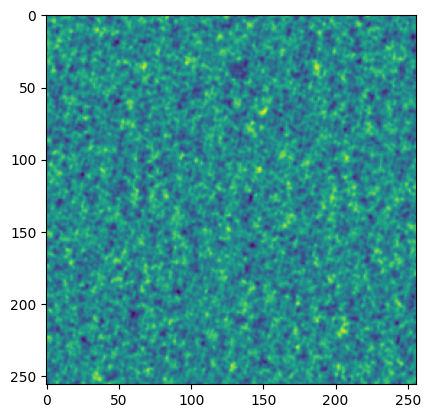

Step 10, Total loss 0.244838


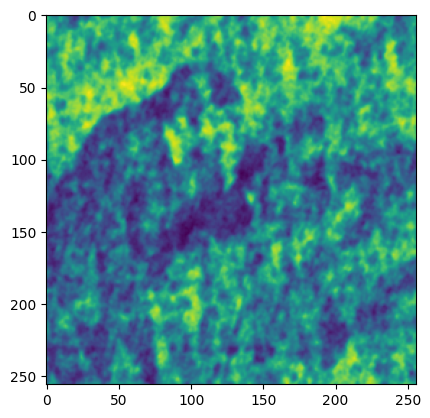

Step 20, Total loss 0.066118


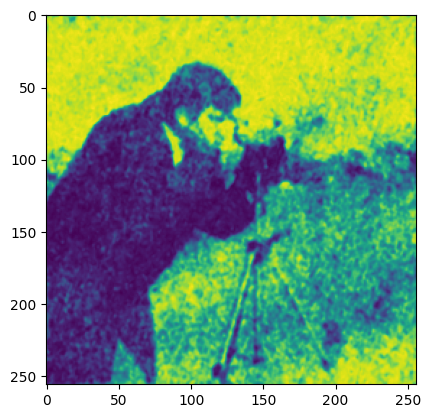

Step 30, Total loss 0.014603


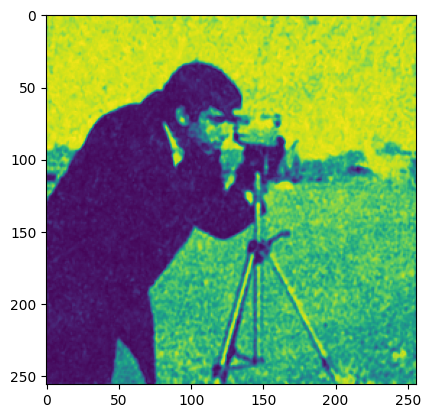

Step 40, Total loss 0.006312


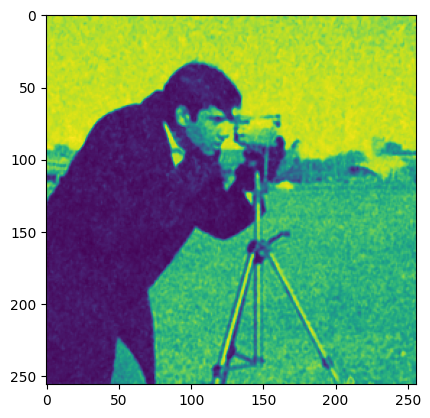

Step 50, Total loss 0.003379


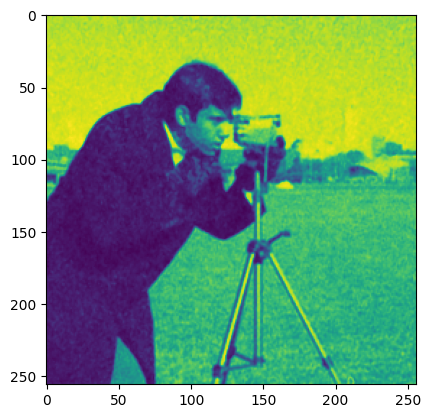

Step 60, Total loss 0.001972


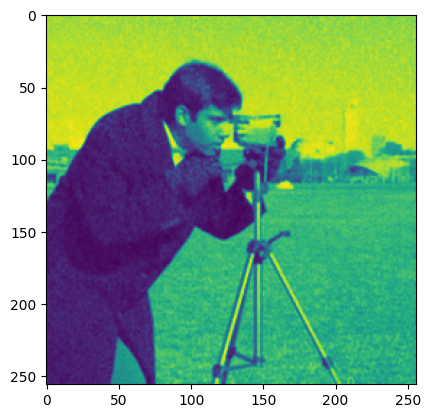

Step 70, Total loss 0.001283


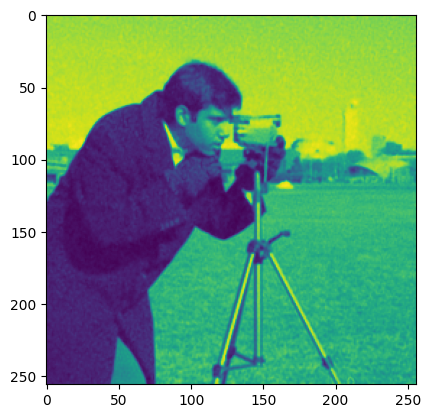

Step 80, Total loss 0.000893


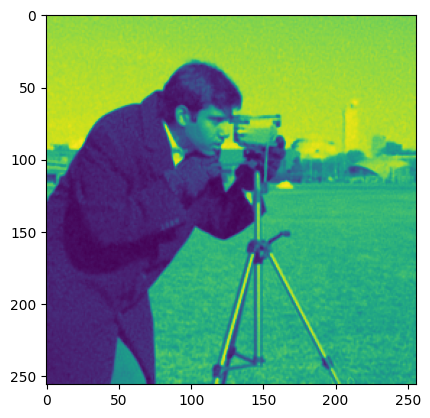

Step 90, Total loss 0.000673


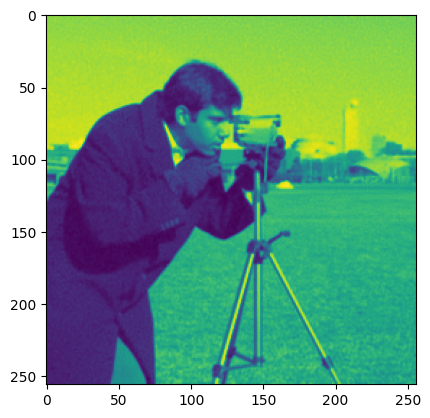

Step 100, Total loss 0.001675


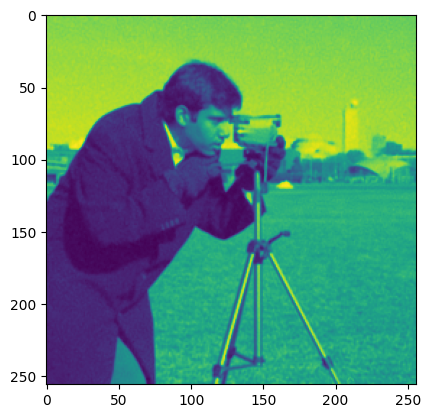

Step 110, Total loss 0.000608


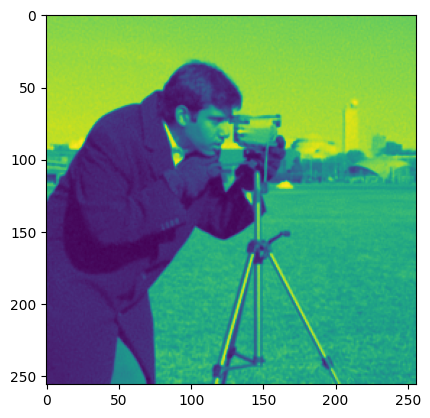

Step 120, Total loss 0.000414


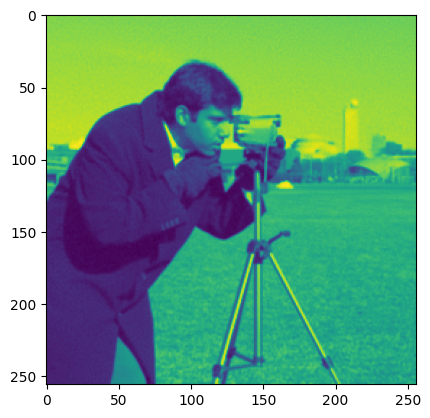

Step 130, Total loss 0.000346


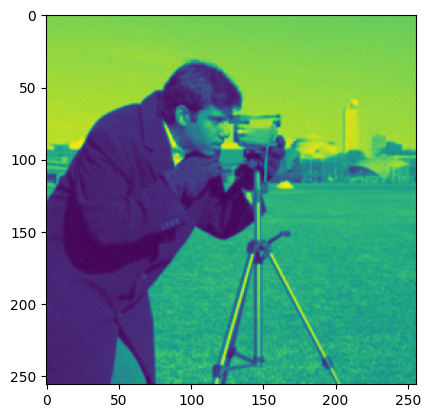

Step 140, Total loss 0.000307


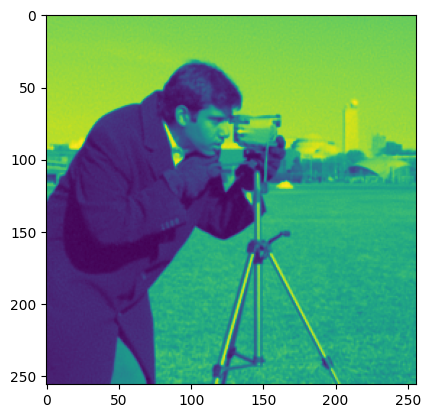

Step 150, Total loss 0.000252


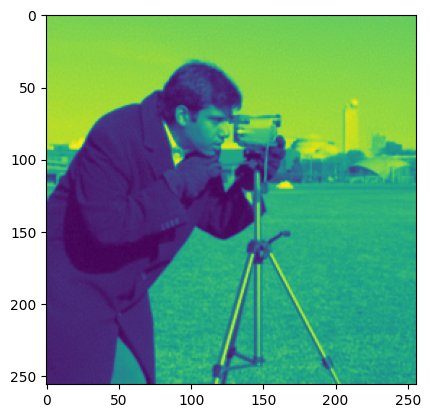

Step 160, Total loss 0.000226


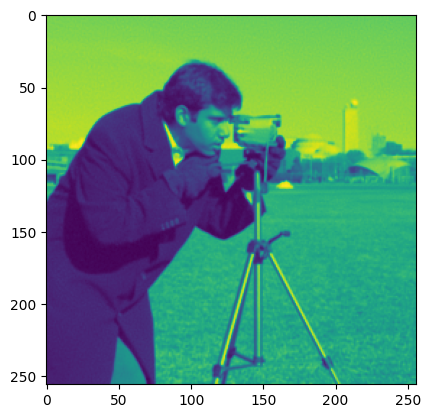

Step 170, Total loss 0.000202


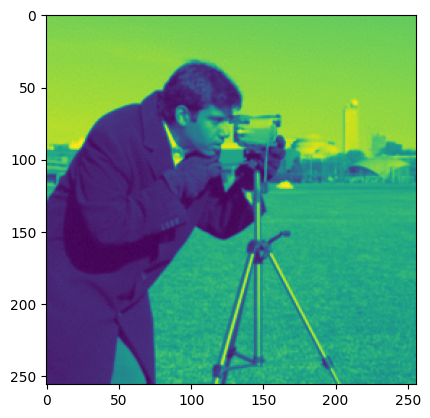

Step 180, Total loss 0.000182


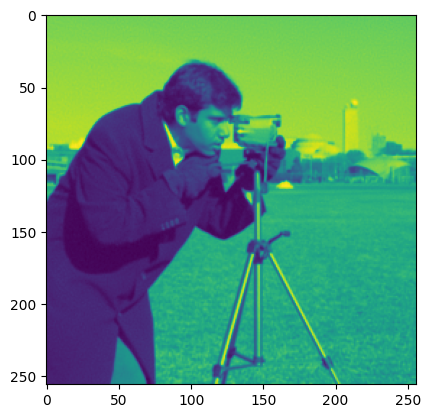

Step 190, Total loss 0.000166


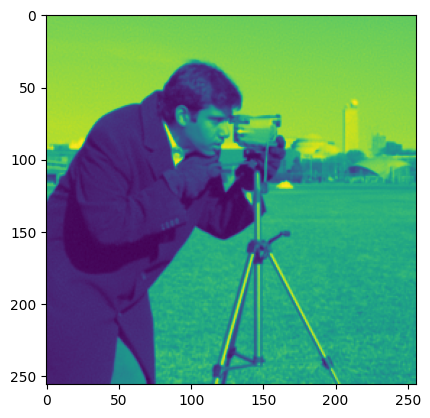

Step 200, Total loss 0.000208


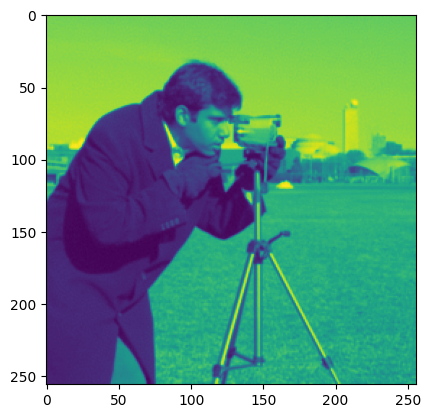

Step 210, Total loss 0.000684


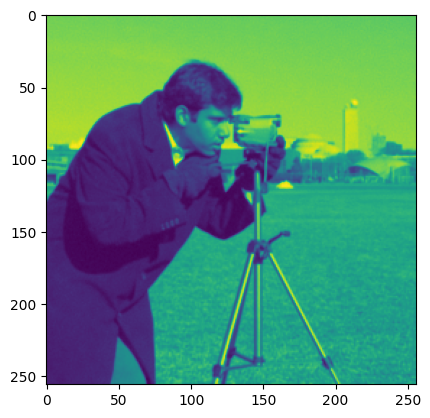

Step 220, Total loss 0.000148


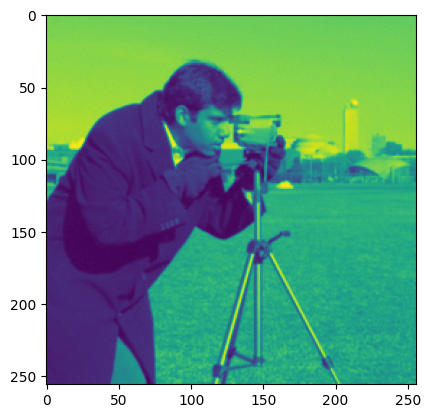

Step 230, Total loss 0.000148


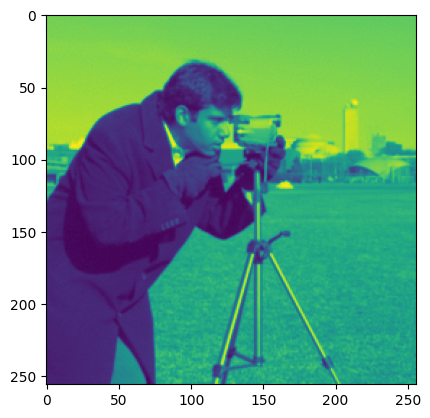

Step 240, Total loss 0.000130


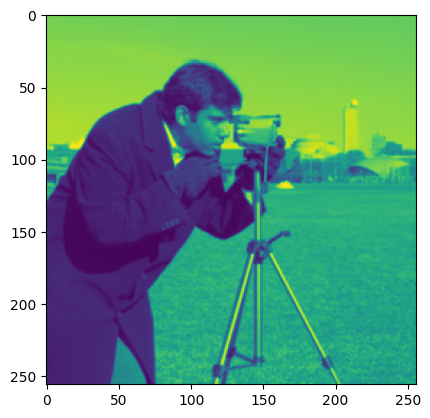

Step 250, Total loss 0.000108


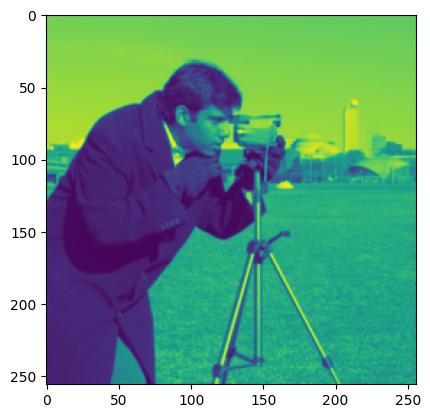

Step 260, Total loss 0.000098


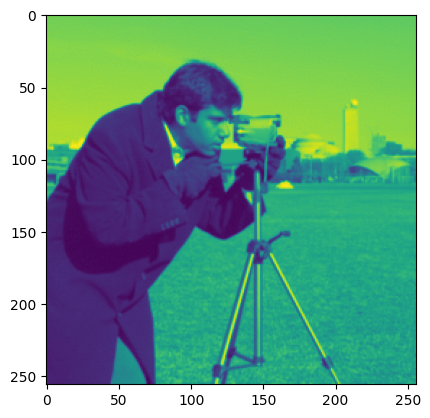

Step 270, Total loss 0.000093


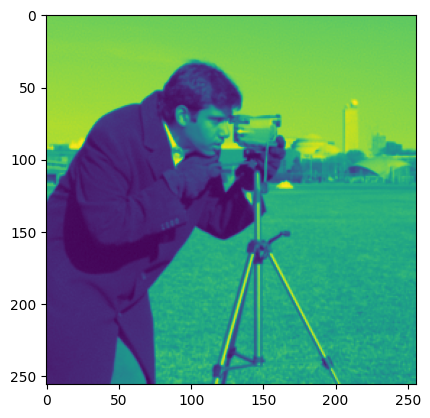

Step 280, Total loss 0.000085


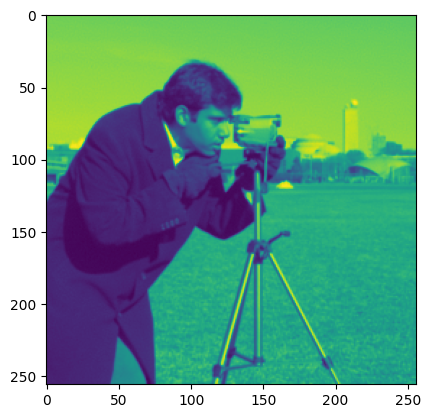

Step 290, Total loss 0.000079


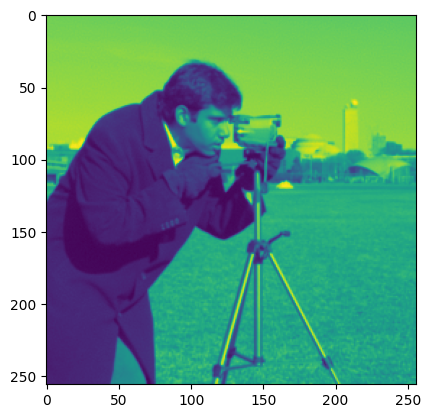

Step 300, Total loss 0.000074


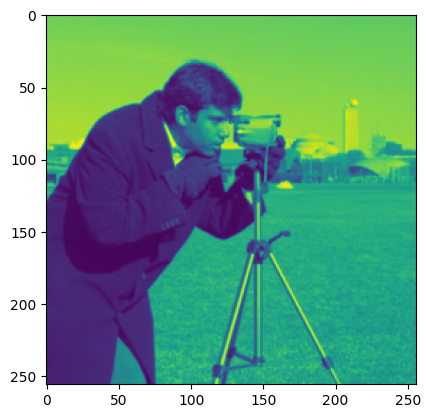

Step 310, Total loss 0.000069


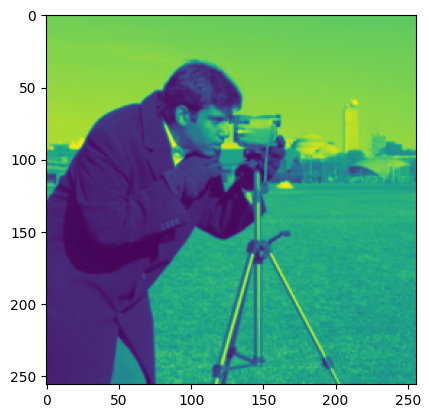

Step 320, Total loss 0.000065


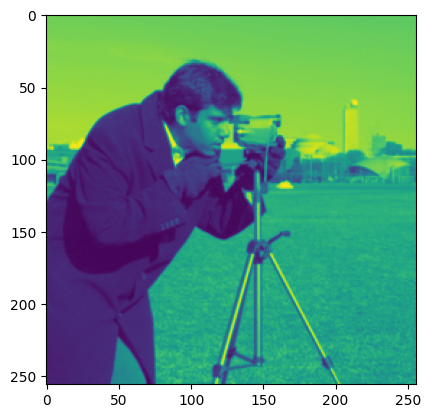

Step 330, Total loss 0.000061


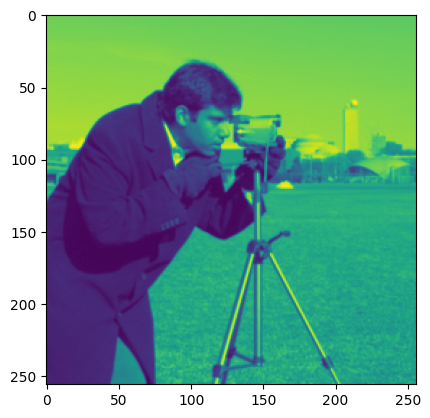

Step 340, Total loss 0.000057


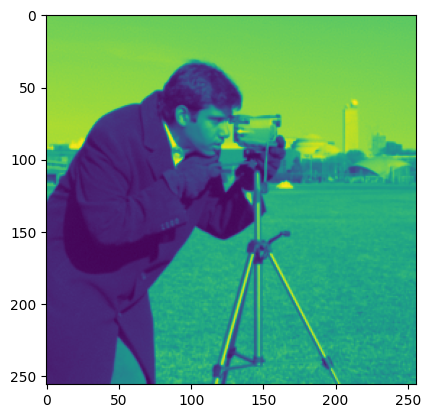

Step 350, Total loss 0.000054


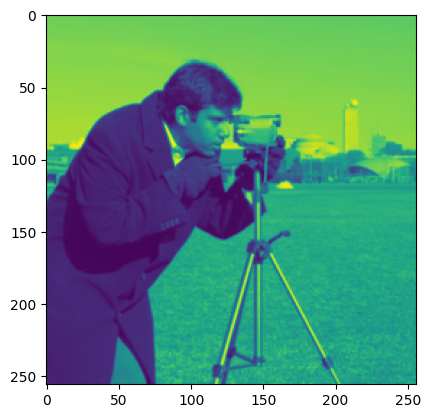

Step 360, Total loss 0.000127


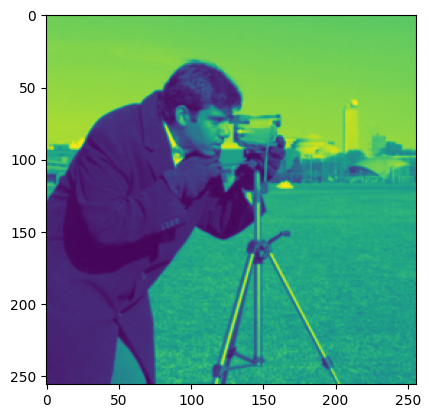

Step 370, Total loss 0.000785


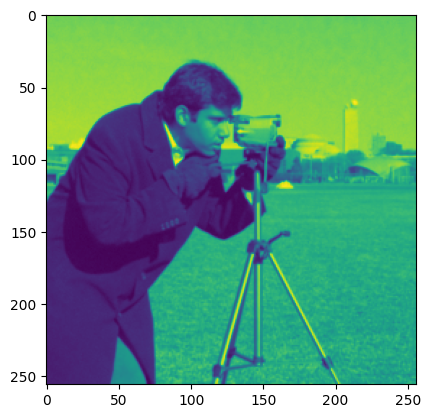

Step 380, Total loss 0.000142


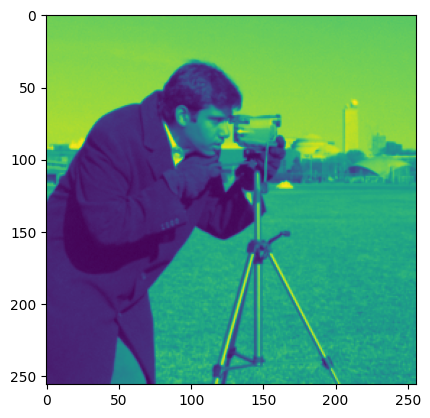

Step 390, Total loss 0.000160


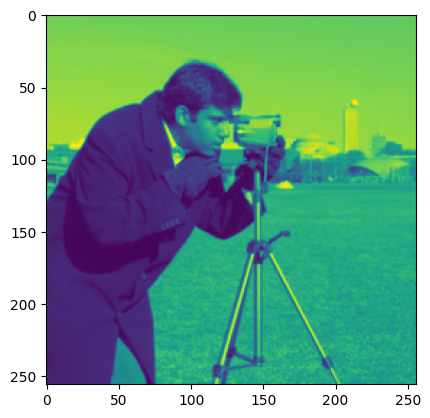

Step 400, Total loss 0.000071


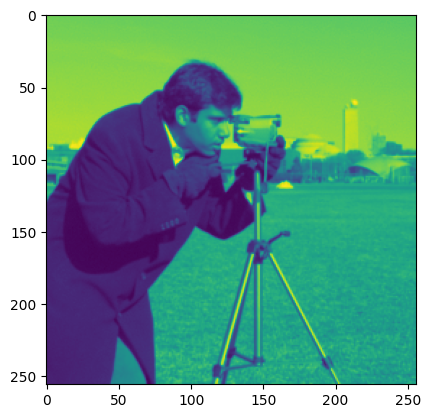

Step 410, Total loss 0.000045


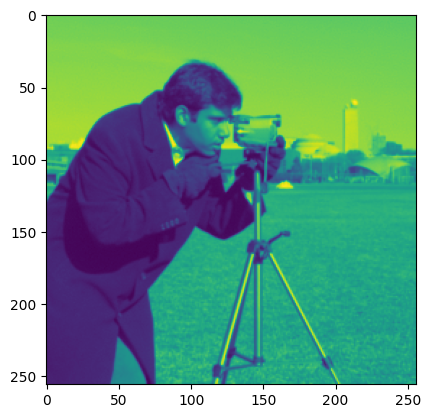

Step 420, Total loss 0.000041


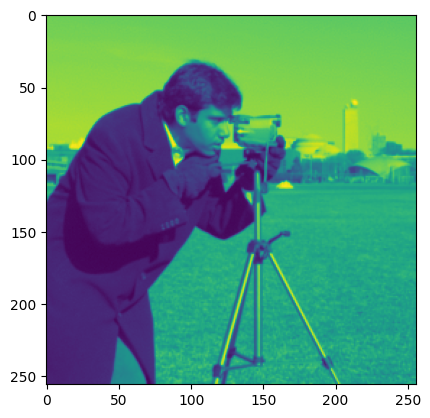

Step 430, Total loss 0.000038


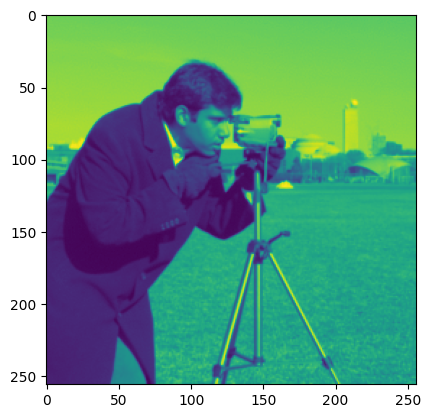

Step 440, Total loss 0.000036


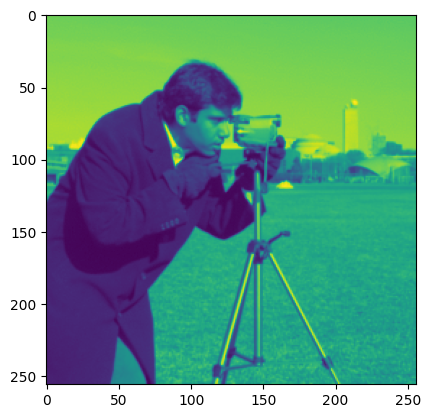

Step 450, Total loss 0.000034


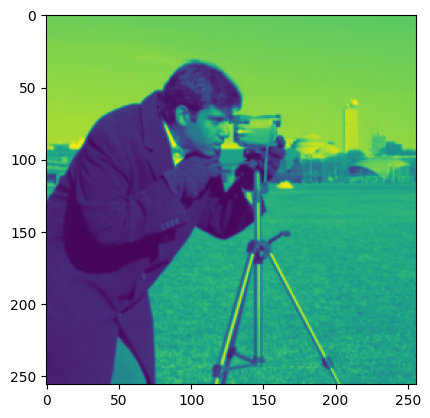

Step 460, Total loss 0.000032


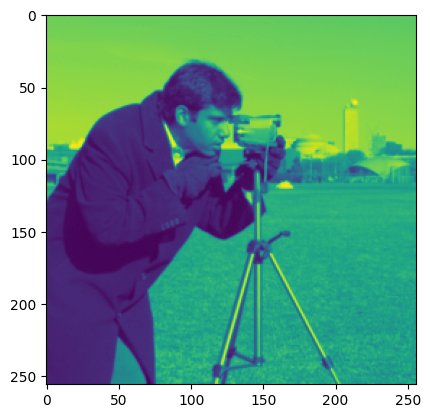

Step 470, Total loss 0.000030


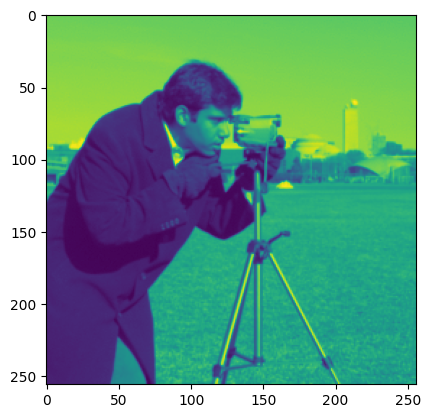

Step 480, Total loss 0.000029


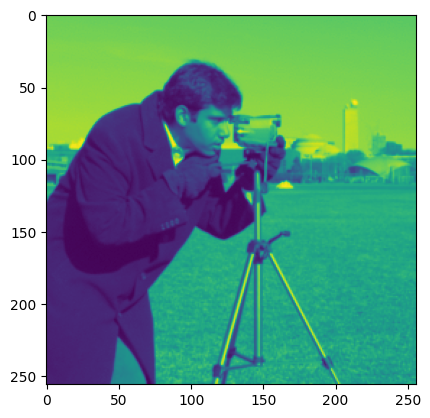

Step 490, Total loss 0.000027


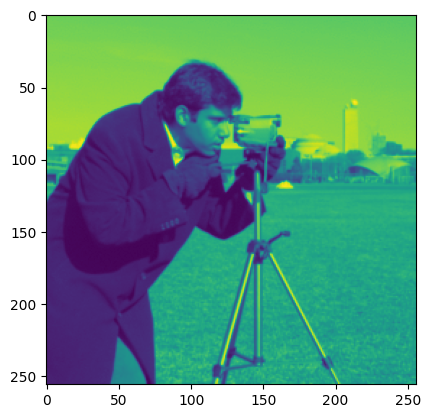

Step 499, Total loss 0.000026


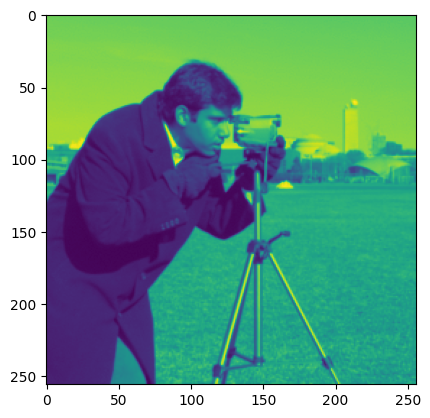

In [20]:
losses['ffsiren'], outputs['ffsiren'] = train(ffsiren, "ffsiren", dataloader, total_steps, steps_til_summary)

Step 0, Total loss 0.325128


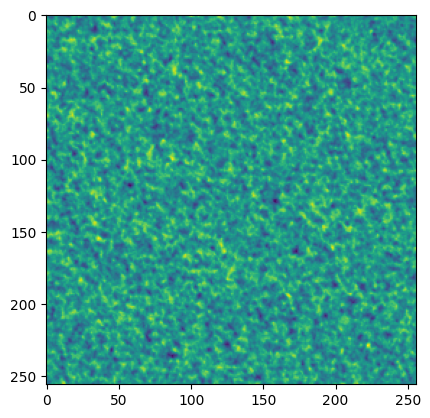

Step 10, Total loss 0.319557


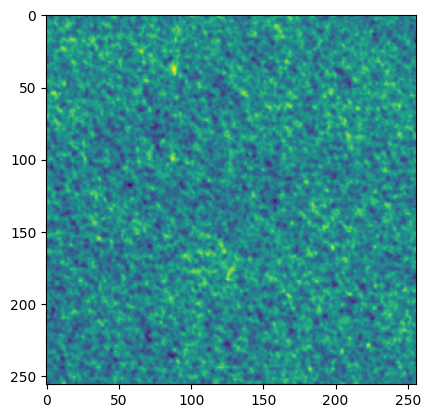

Step 20, Total loss 0.313236


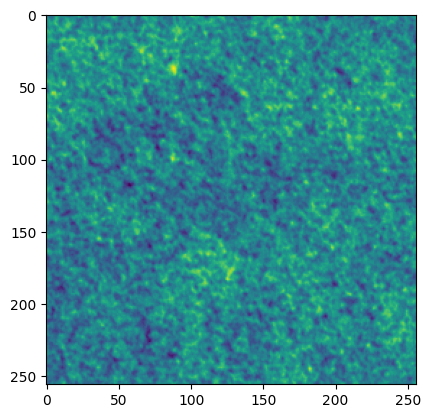

Step 30, Total loss 0.302662


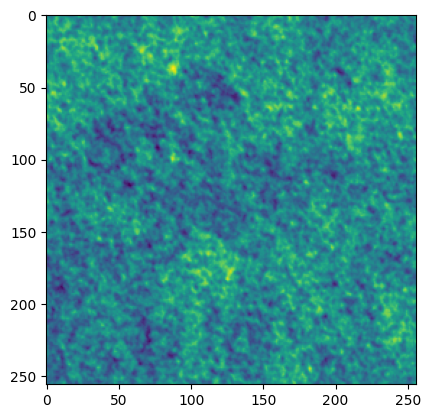

Step 40, Total loss 0.284107


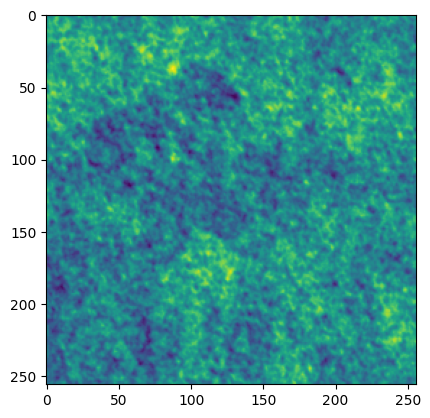

Step 50, Total loss 0.253479


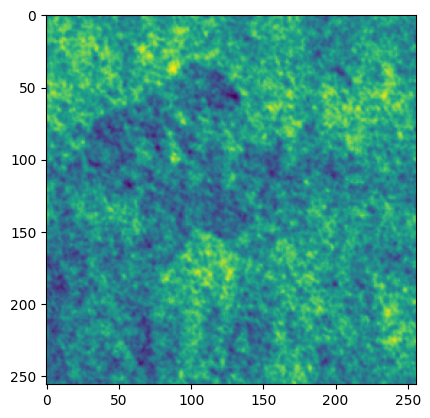

Step 60, Total loss 0.208288


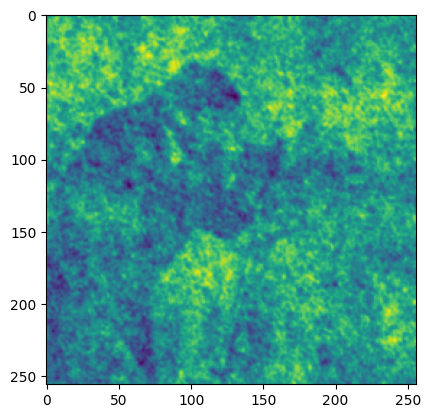

Step 70, Total loss 0.151413


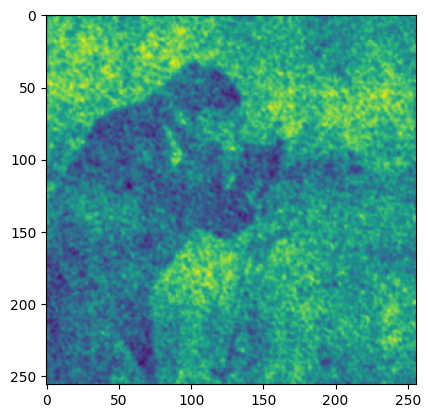

Step 80, Total loss 0.095537


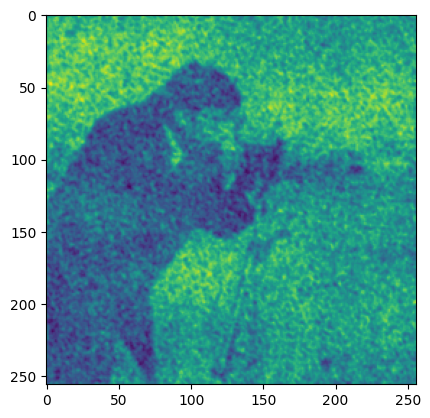

Step 90, Total loss 0.056187


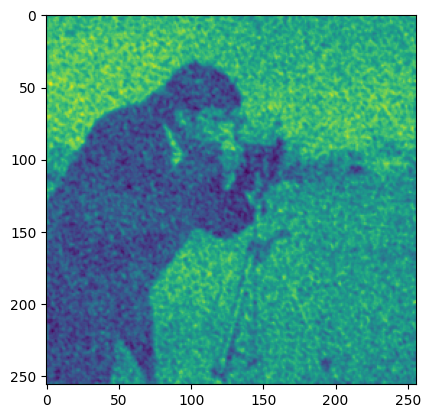

Step 100, Total loss 0.034461


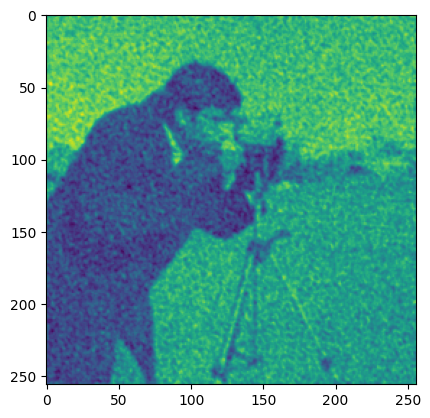

Step 110, Total loss 0.022004


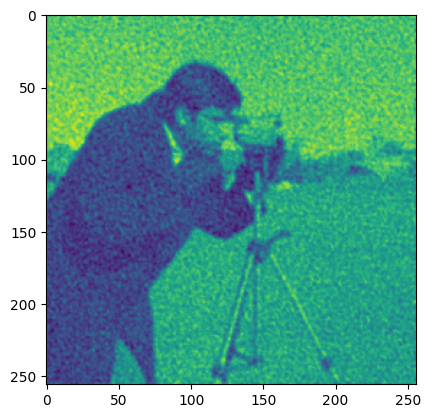

Step 120, Total loss 0.015056


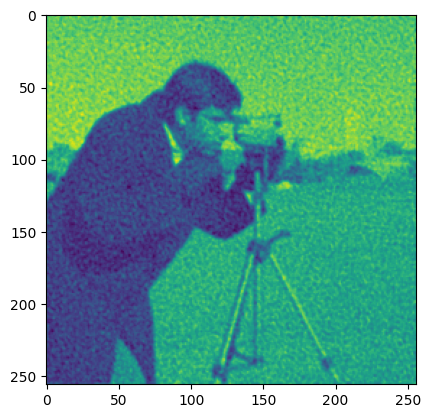

Step 130, Total loss 0.011089


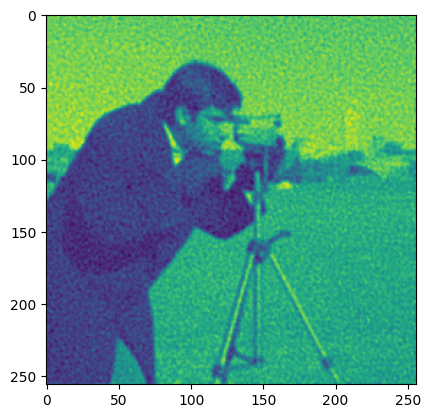

Step 140, Total loss 0.008630


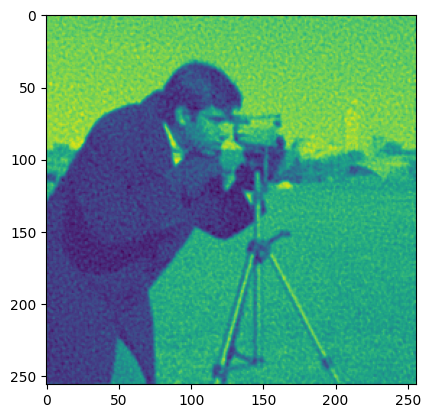

Step 150, Total loss 0.007002


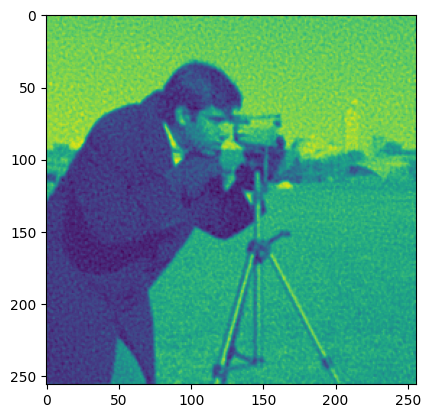

Step 160, Total loss 0.005855


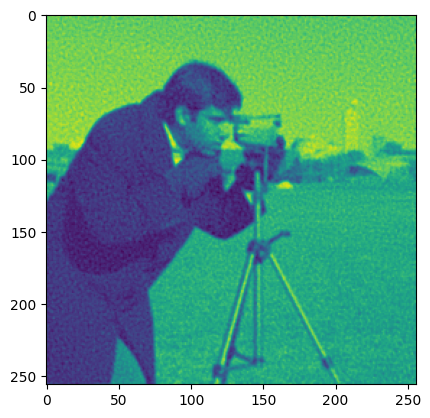

Step 170, Total loss 0.005011


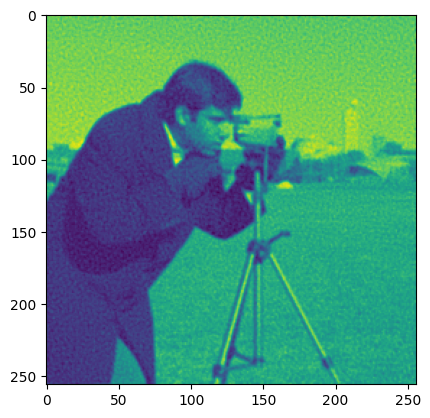

Step 180, Total loss 0.004390


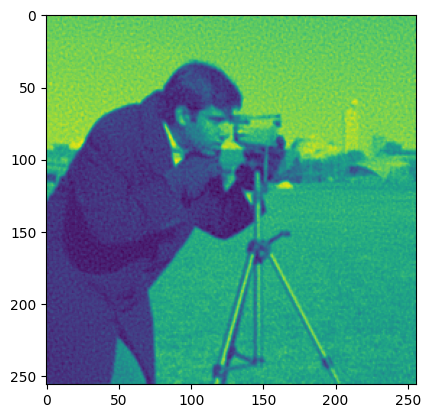

Step 190, Total loss 0.003868


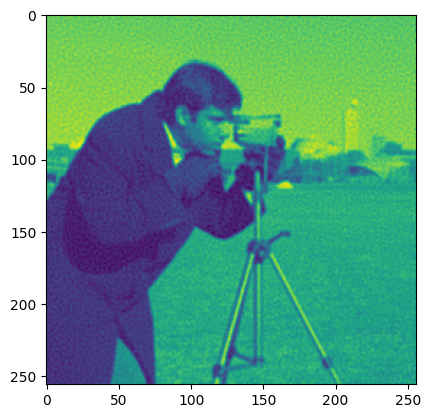

Step 200, Total loss 0.003453


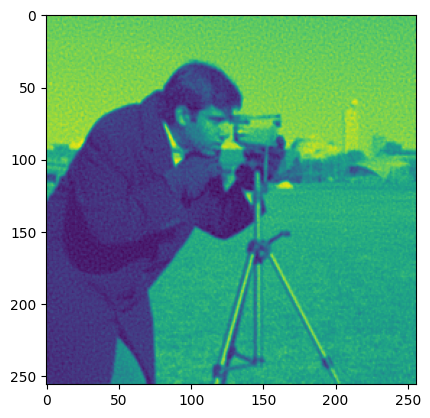

Step 210, Total loss 0.003115


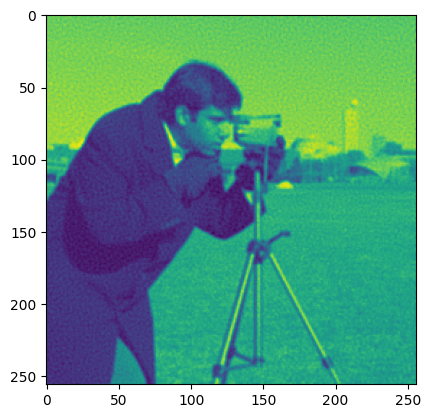

Step 220, Total loss 0.002831


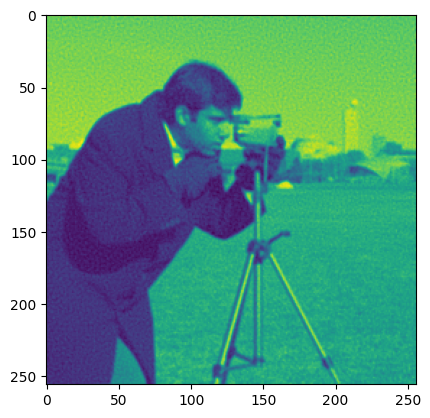

Step 230, Total loss 0.002588


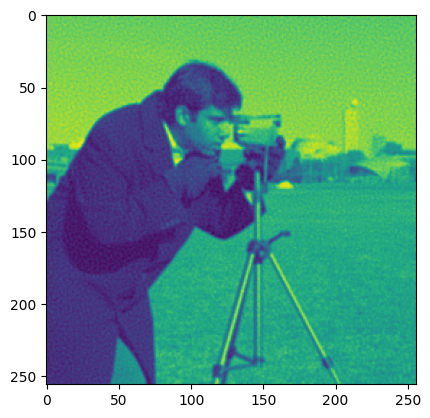

Step 240, Total loss 0.002378


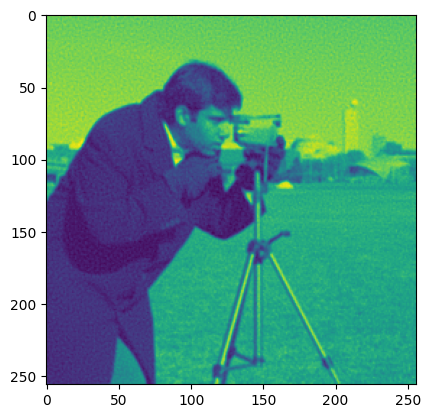

Step 250, Total loss 0.002194


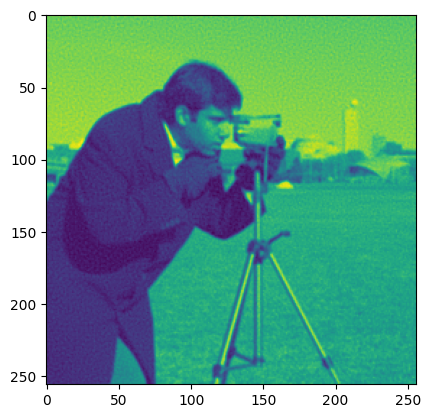

Step 260, Total loss 0.002033


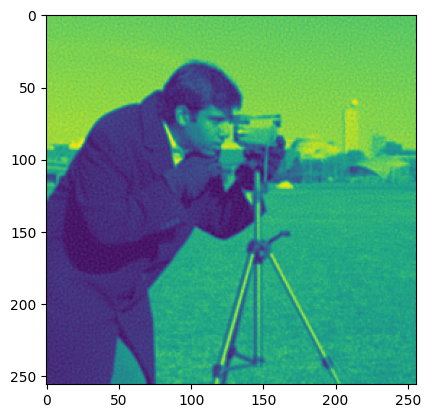

Step 270, Total loss 0.001890


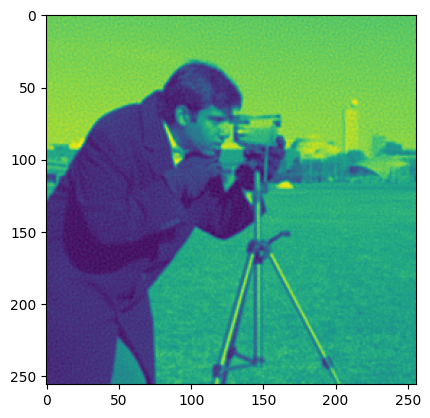

Step 280, Total loss 0.001800


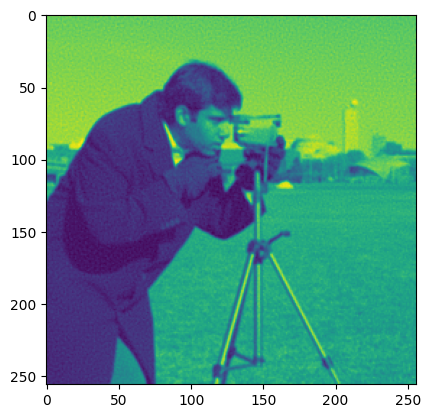

Step 290, Total loss 0.001659


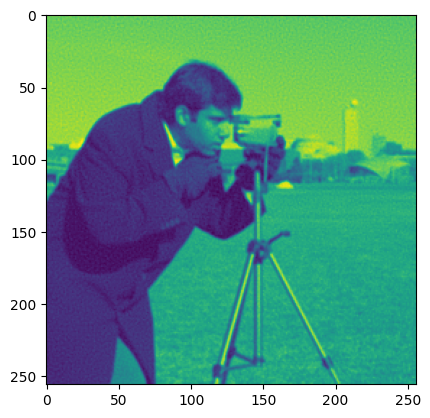

Step 300, Total loss 0.001555


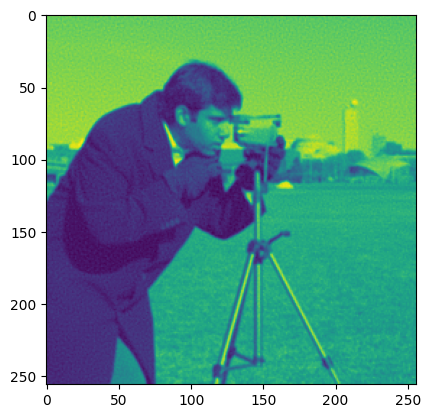

Step 310, Total loss 0.001461


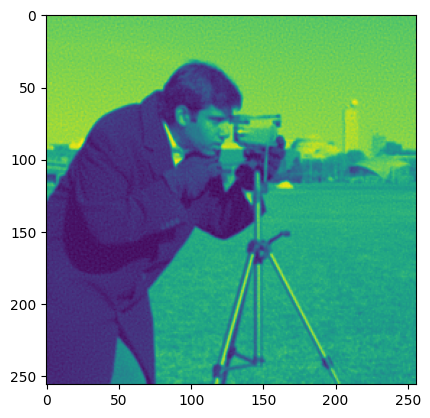

Step 320, Total loss 0.001375


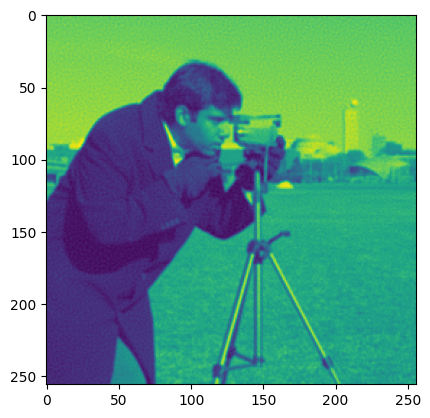

Step 330, Total loss 0.001298


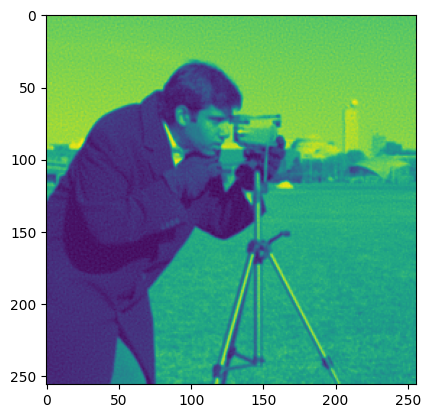

Step 340, Total loss 0.001227


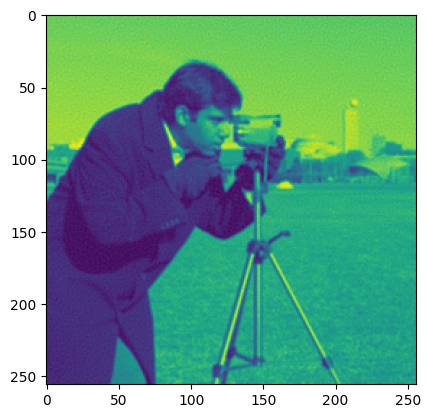

Step 350, Total loss 0.001162


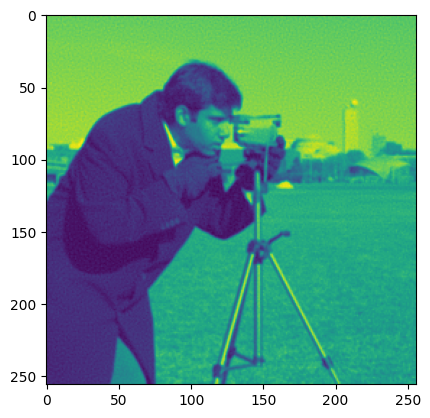

Step 360, Total loss 0.001102


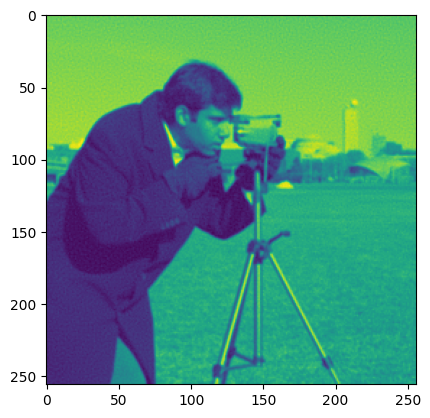

Step 370, Total loss 0.001047


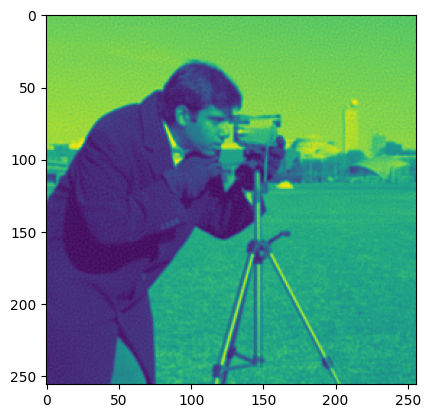

Step 380, Total loss 0.001025


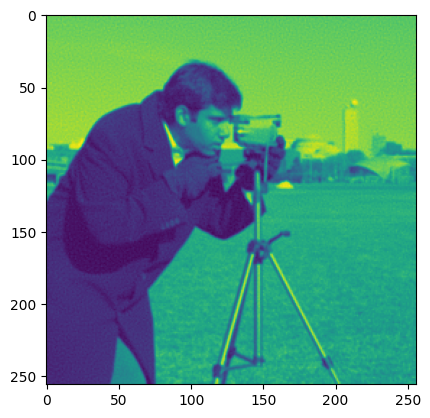

Step 390, Total loss 0.000983


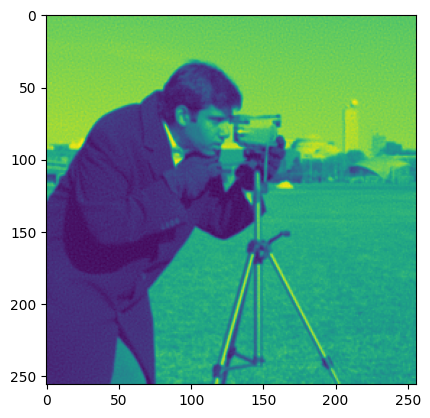

Step 400, Total loss 0.000913


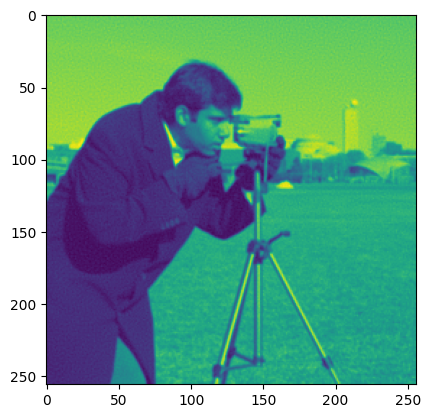

Step 410, Total loss 0.000864


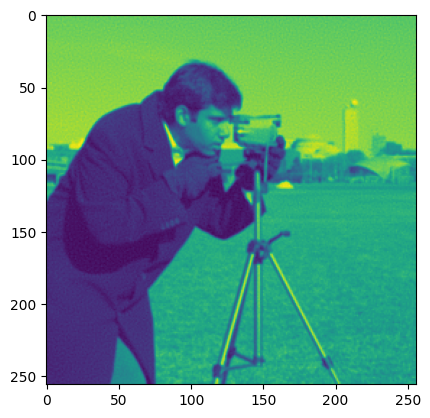

Step 420, Total loss 0.000825


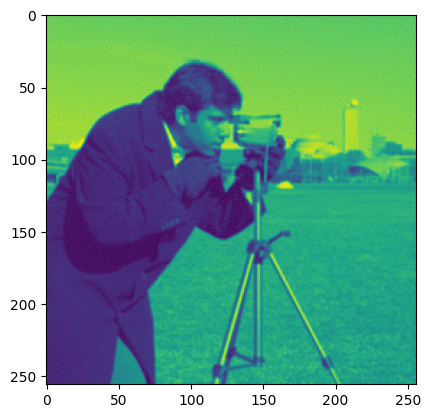

Step 430, Total loss 0.000789


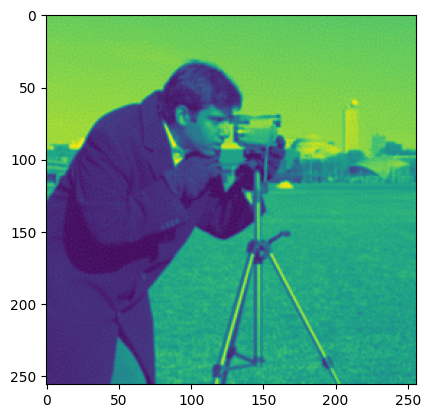

Step 440, Total loss 0.000755


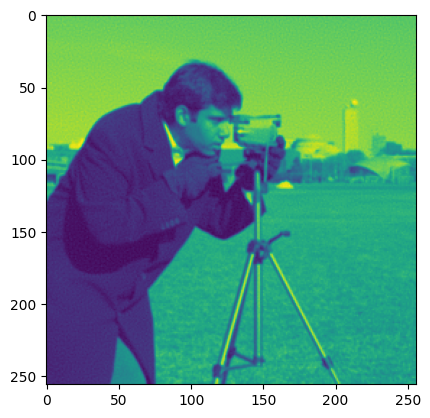

Step 450, Total loss 0.000723


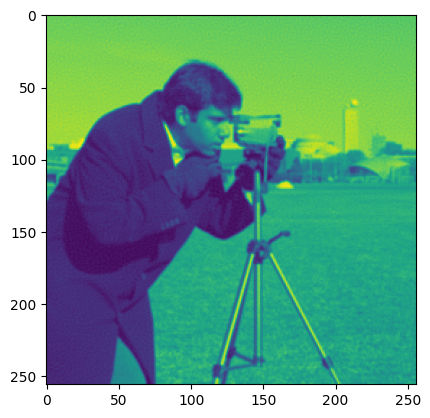

Step 460, Total loss 0.000693


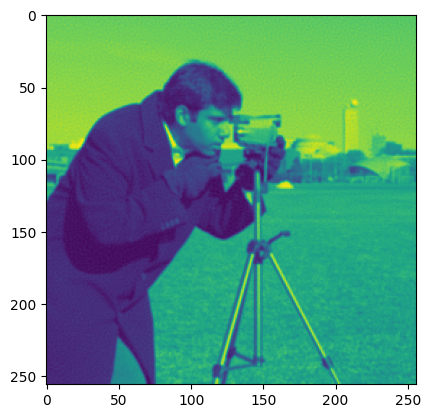

Step 470, Total loss 0.000665


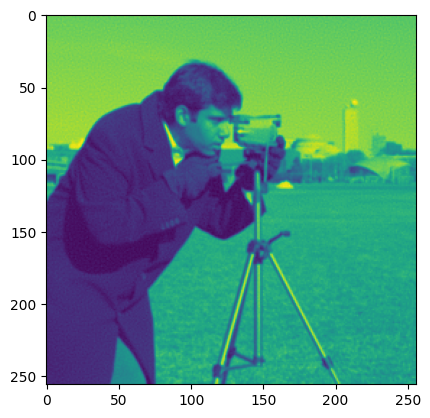

Step 480, Total loss 0.000638


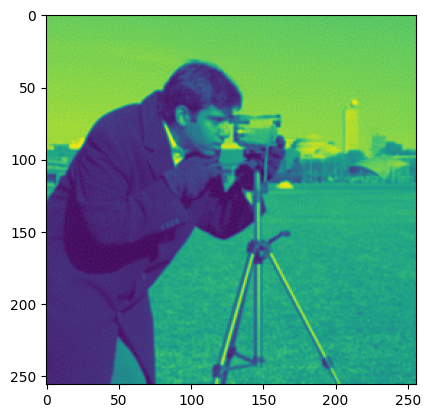

Step 490, Total loss 0.000613


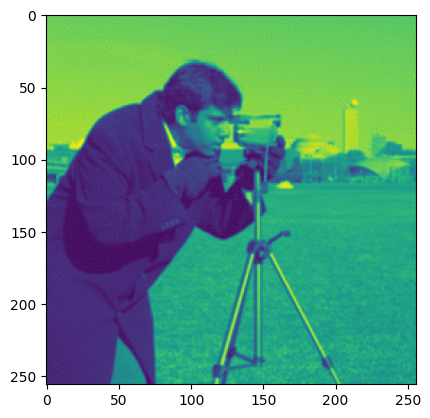

Step 499, Total loss 0.000607


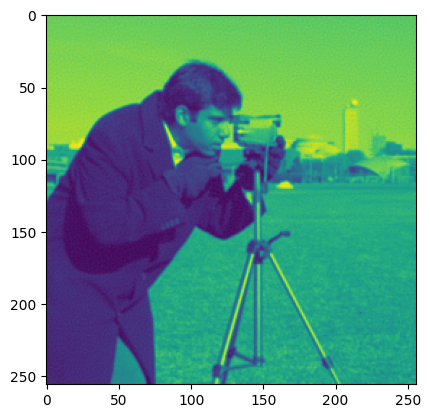

In [21]:
losses['ffn'], outputs['ffn'] = train(ffn, "ffn", dataloader, total_steps, steps_til_summary)

Step 0, Total loss 0.325285


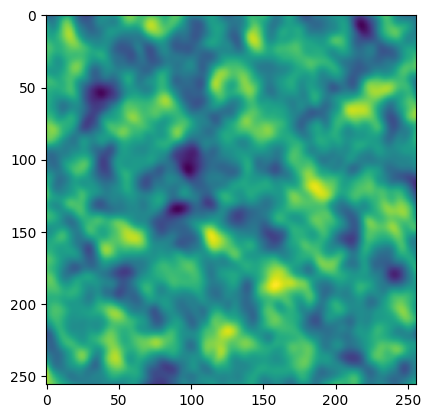

Step 10, Total loss 0.046095


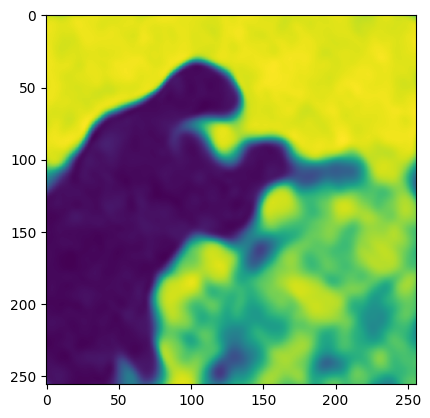

Step 20, Total loss 0.020861


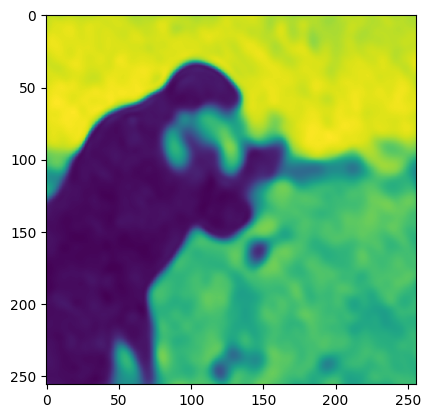

Step 30, Total loss 0.015311


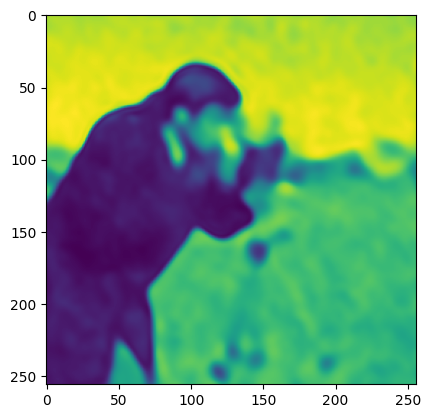

Step 40, Total loss 0.012187


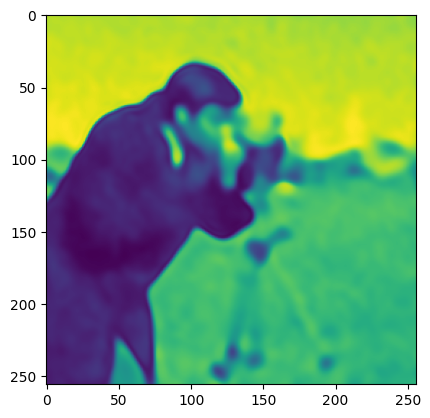

Step 50, Total loss 0.010447


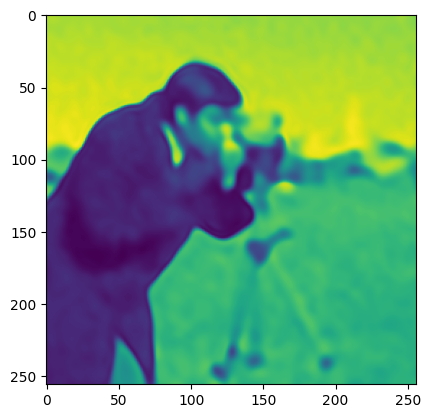

Step 60, Total loss 0.009226


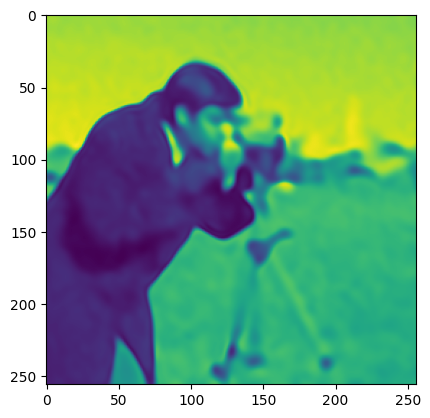

Step 70, Total loss 0.008319


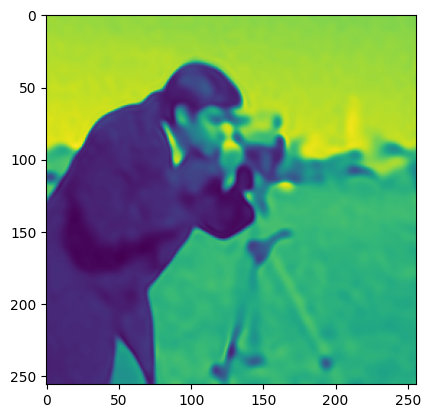

Step 80, Total loss 0.007574


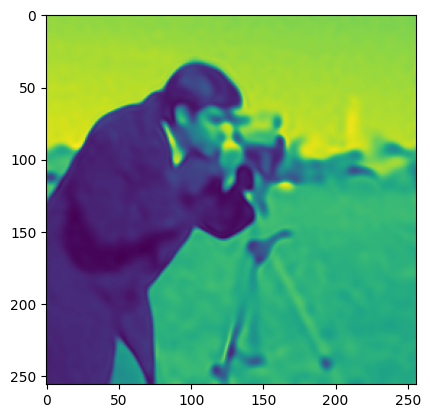

Step 90, Total loss 0.006935


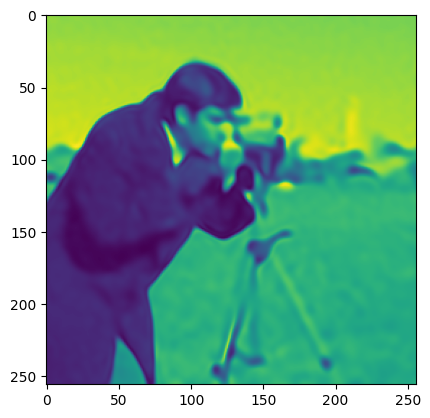

Step 100, Total loss 0.006366


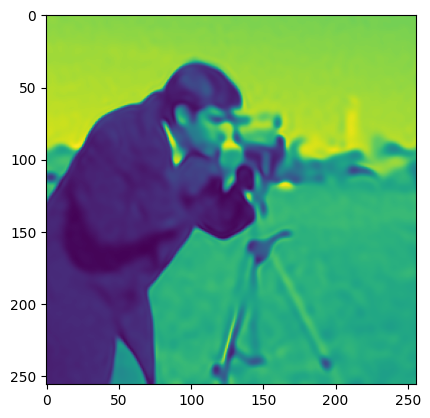

Step 110, Total loss 0.005834


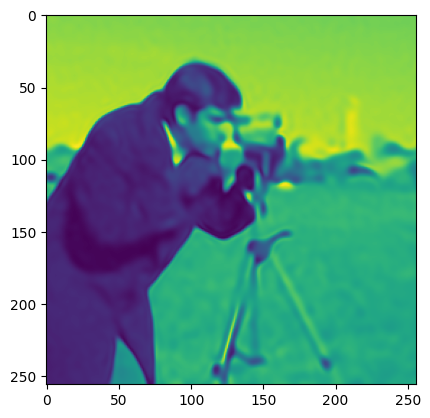

Step 120, Total loss 0.005336


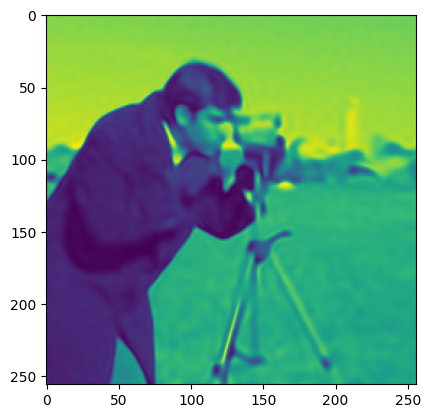

Step 130, Total loss 0.004861


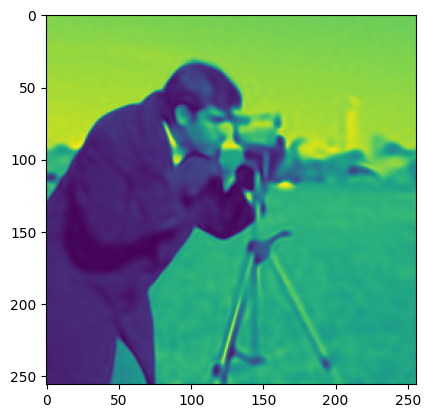

Step 140, Total loss 0.004394


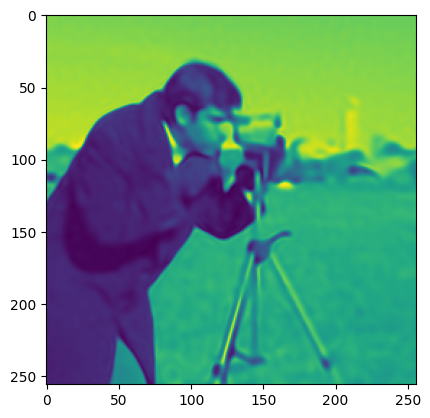

Step 150, Total loss 0.003926


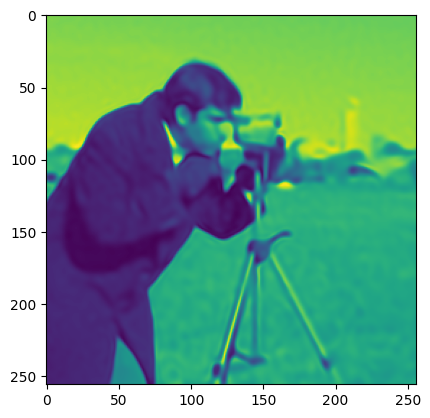

Step 160, Total loss 0.003958


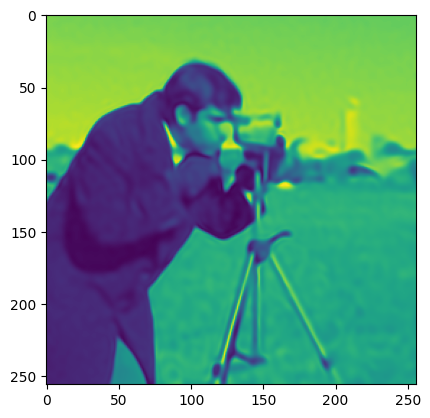

Step 170, Total loss 0.003149


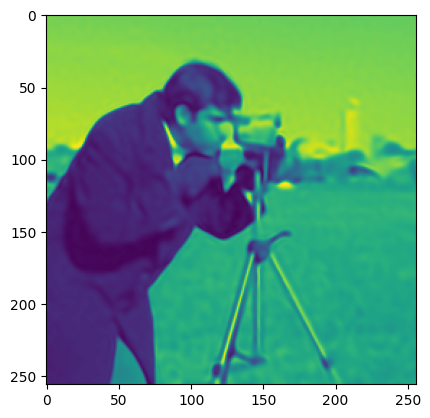

Step 180, Total loss 0.002831


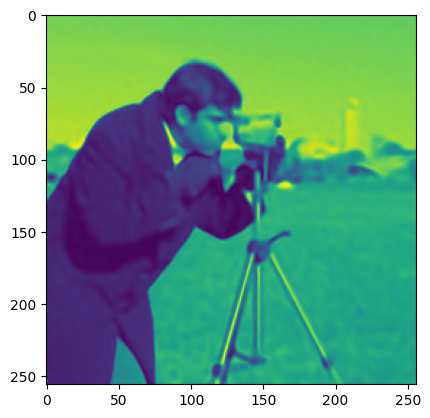

Step 190, Total loss 0.002582


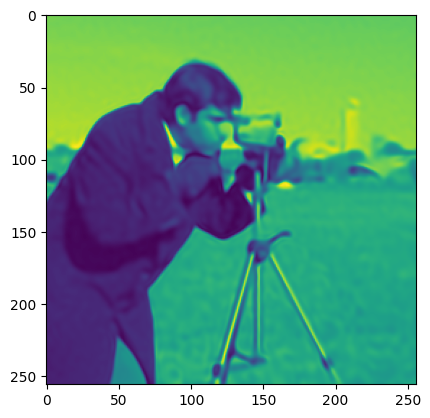

Step 200, Total loss 0.002400


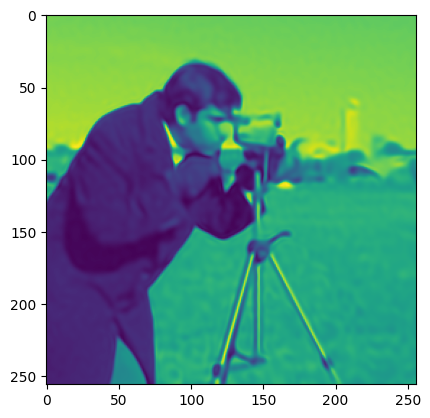

Step 210, Total loss 0.002242


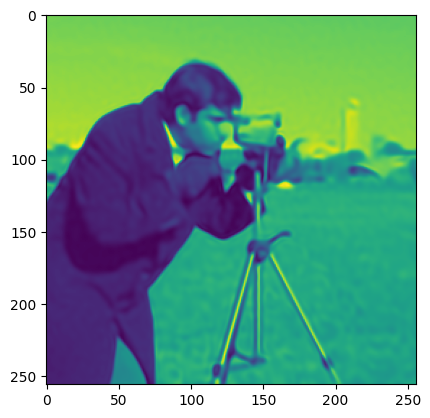

Step 220, Total loss 0.002111


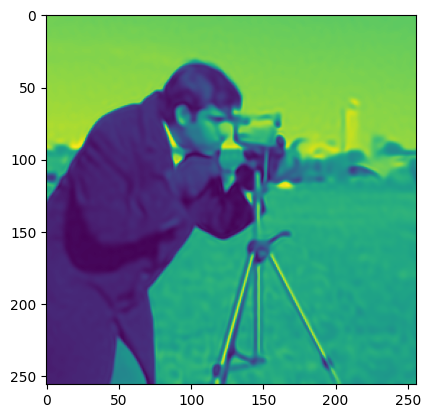

Step 230, Total loss 0.001995


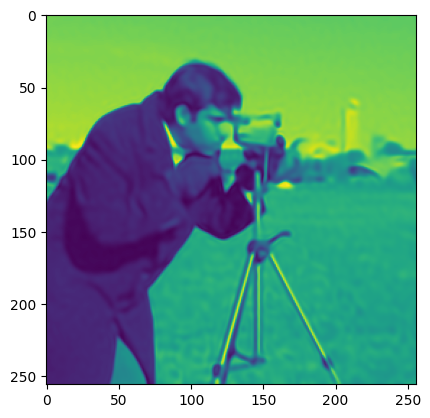

Step 240, Total loss 0.001891


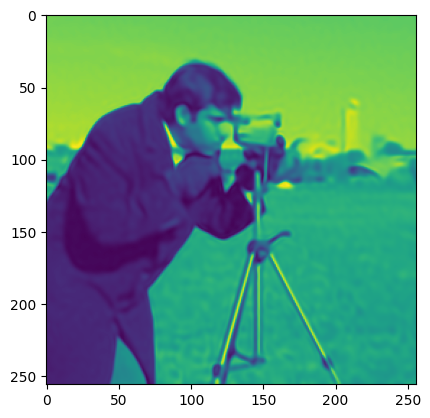

Step 250, Total loss 0.001821


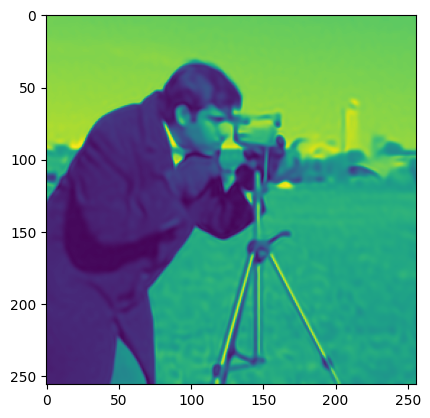

Step 260, Total loss 0.001921


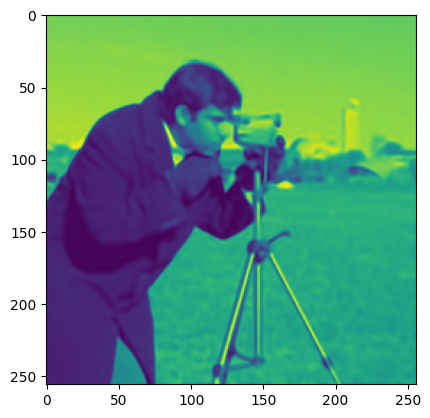

Step 270, Total loss 0.001651


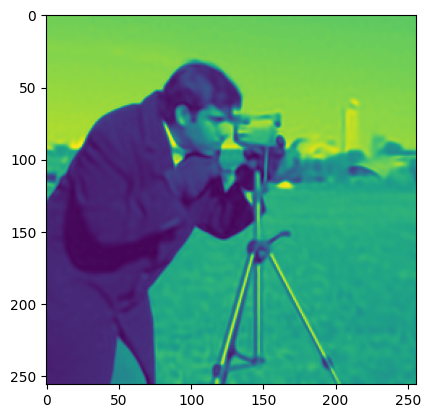

Step 280, Total loss 0.001576


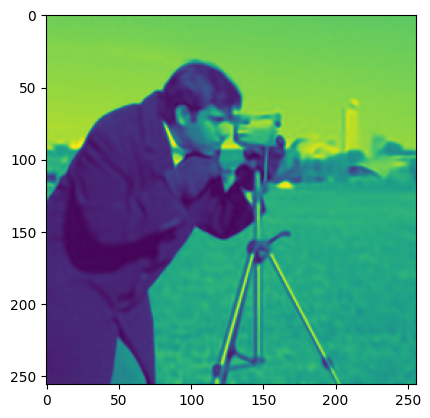

Step 290, Total loss 0.001511


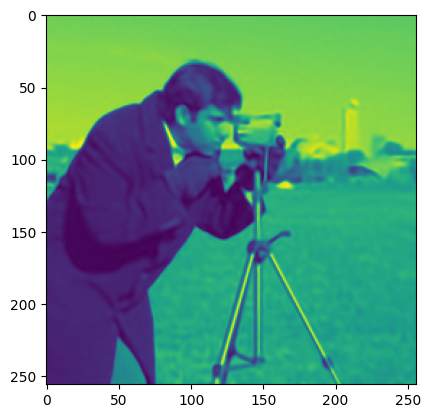

Step 300, Total loss 0.001454


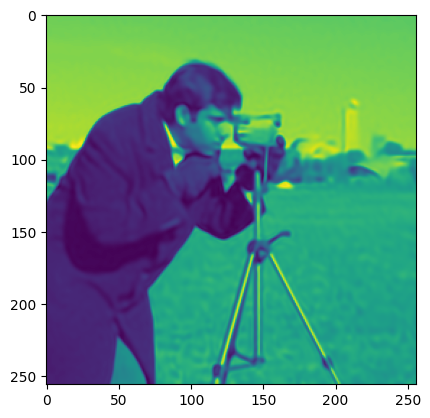

Step 310, Total loss 0.001397


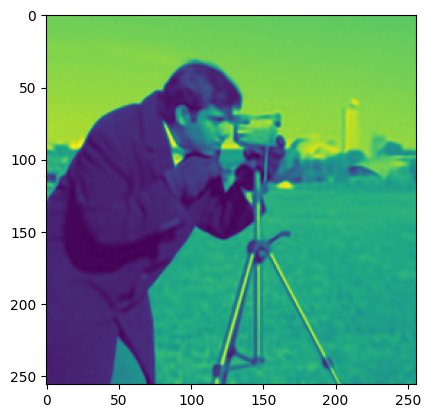

Step 320, Total loss 0.001347


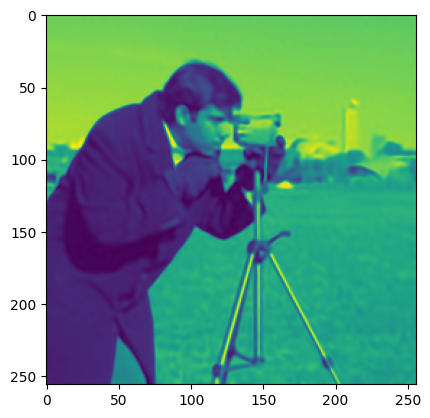

Step 330, Total loss 0.001301


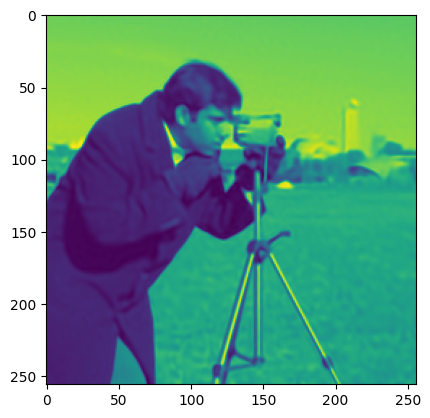

Step 340, Total loss 0.001258


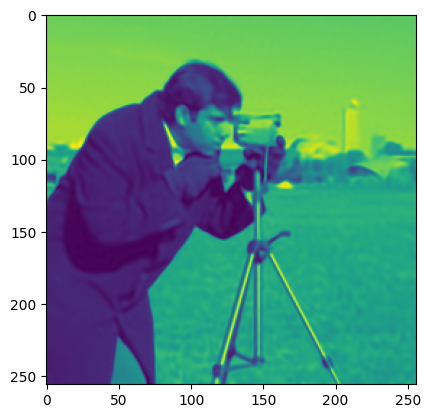

Step 350, Total loss 0.001218


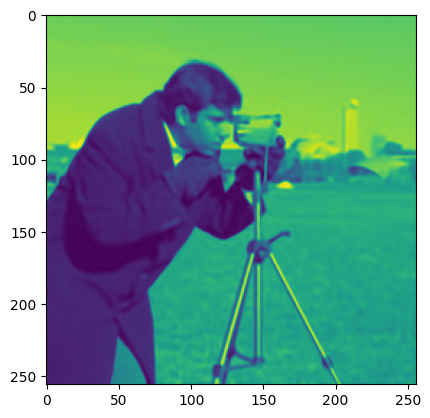

Step 360, Total loss 0.001181


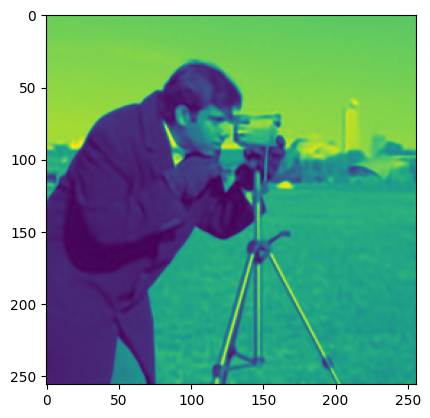

Step 370, Total loss 0.001146


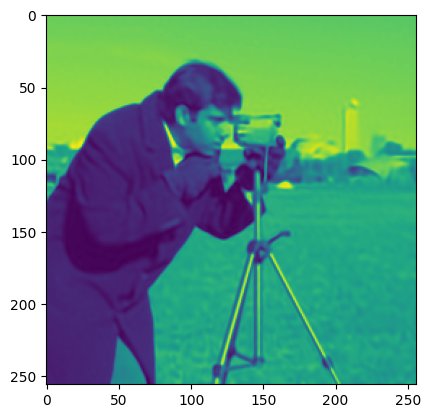

Step 380, Total loss 0.001113


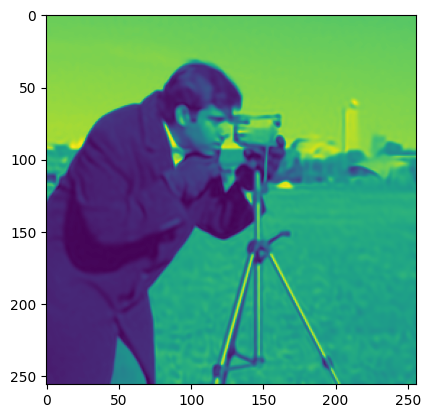

Step 390, Total loss 0.001170


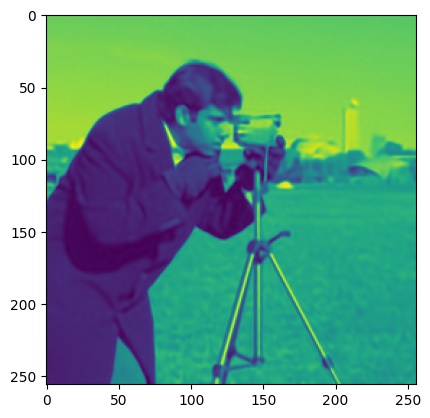

Step 400, Total loss 0.001355


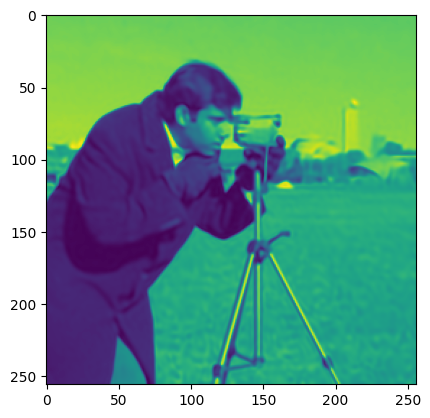

Step 410, Total loss 0.001086


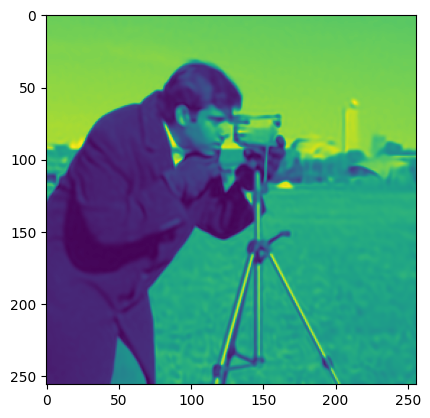

Step 420, Total loss 0.001021


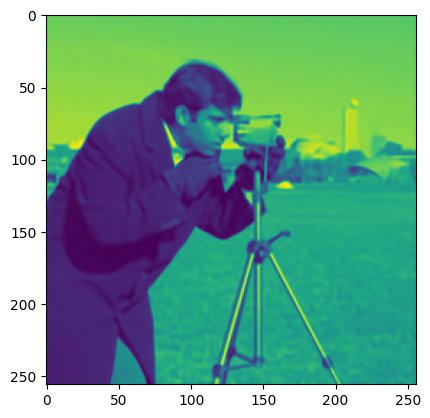

Step 430, Total loss 0.000987


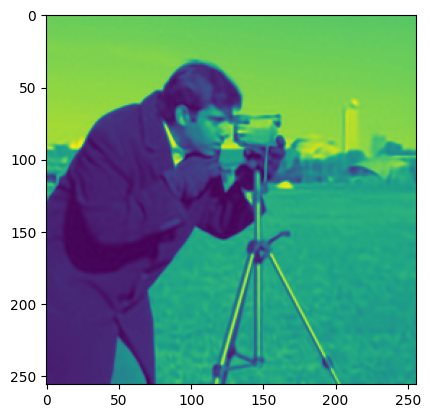

Step 440, Total loss 0.000960


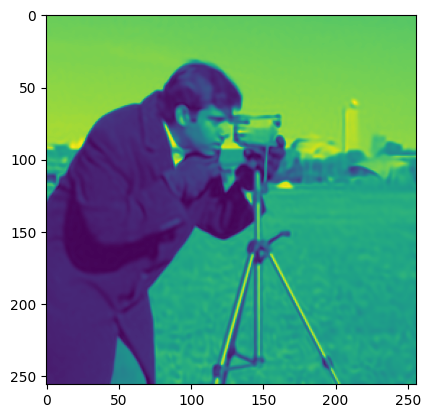

Step 450, Total loss 0.000934


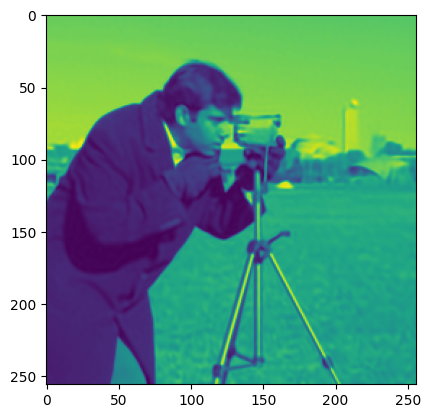

Step 460, Total loss 0.000912


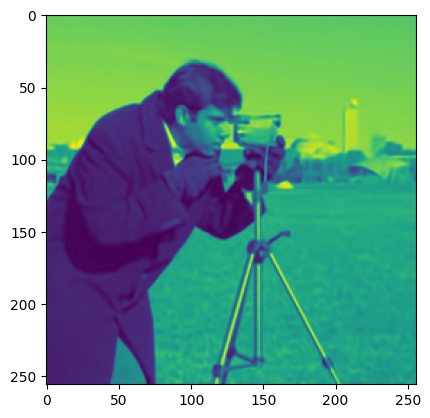

Step 470, Total loss 0.000891


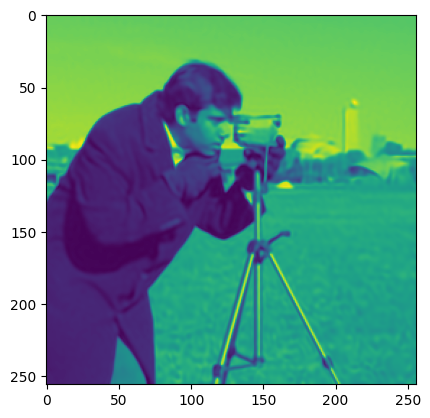

Step 480, Total loss 0.000871


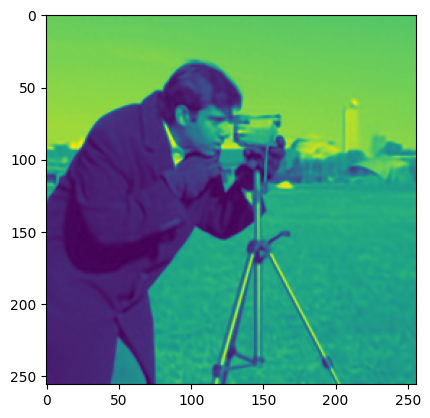

Step 490, Total loss 0.000852


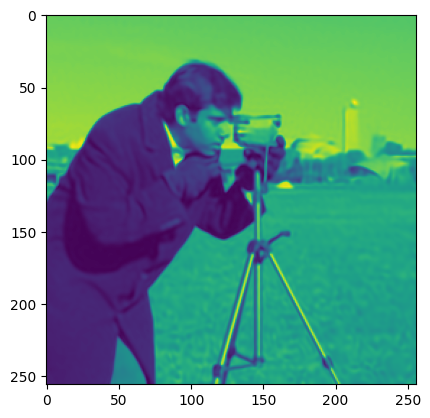

Step 499, Total loss 0.000835


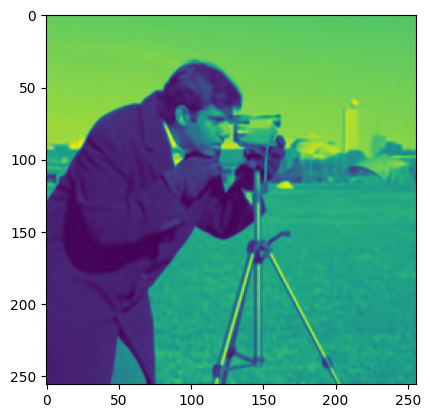

In [22]:
losses['siren'], outputs['siren'] = train(img_siren, "siren", dataloader, total_steps, steps_til_summary)

In [23]:
def loss_to_psnr(loss, max=2):
  return 10*np.log10(max**2/np.asarray(loss))


final loss:
ffsiren: 2.62275952991331e-05
ffn: 0.0006066147470846772
siren: 0.0008351427386514843


Text(0.5, 1.0, 'training loss')

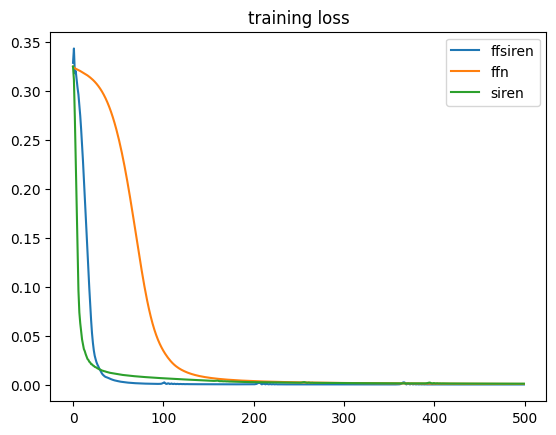

In [24]:
print("final loss:")

for n in losses:
  plt.plot(losses[n], label=n)
  plt.legend()
  print(f"{n}: {losses[n][-1]}")
plt.title("training loss")

PSNR ffsiren: 51.8330151759585
PSNR ffn: 38.191470273255405
PSNR siren: 36.802992819391854


Text(0.5, 1.0, 'PSNR')

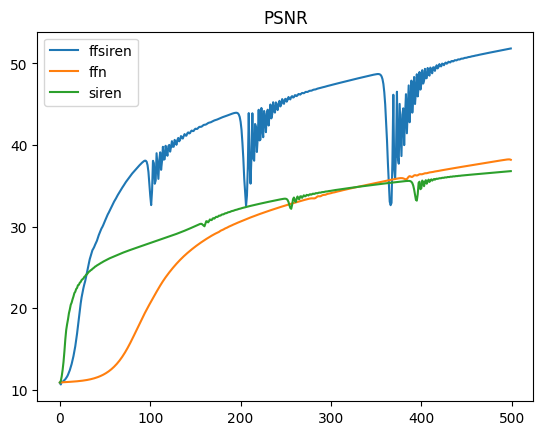

In [31]:
for n in losses:
  plt.plot(loss_to_psnr(losses[n]), label=n)
  print(f"PSNR {n}: {loss_to_psnr(losses[n][-1])}")
  plt.legend()
plt.title("PSNR")

In [26]:
!pip install imageio-ffmpeg
import os, imageio


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [27]:
# Save out video
all_preds = np.concatenate([outputs[n] for n in outputs], axis=-1)
data8 = (255*(np.clip(all_preds, -1, 1)+1)/2).astype(np.uint8)
f = os.path.join('training_convergence.mp4')
imageio.mimwrite(f, data8, fps=20)
N=len(outputs)
# Display video inline
from IPython.display import HTML
from base64 import b64encode
mp4 = open(f, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

In [28]:
HTML(f'''
<video width=1000 controls autoplay loop>
      <source src="{data_url}" type="video/mp4">
</video>
<table width="1000" cellspacing="0" cellpadding="0">
  <tr>{''.join(N*[f'<td width="{1000//len(outputs)}"></td>'])}</tr>
  <tr>{''.join(N*['<td style="text-align:center">{}</td>'])}</tr>
</table>
'''.format(*list(outputs.keys())))

Text(0.5, 1.0, 'groundtruth')

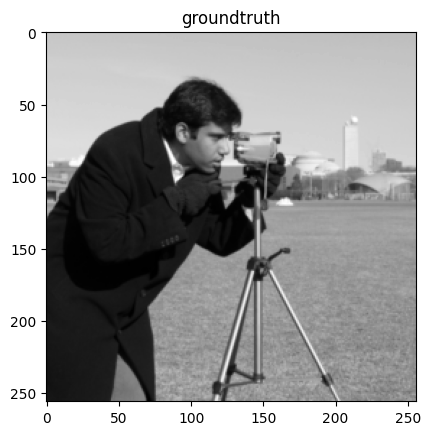

In [29]:
plt.imshow((get_cameraman_tensor(256)+0.5)[0]*255, cmap='gray')
plt.title("groundtruth")

In [30]:
print(data_url)

data:video/mp4;base64,AAAAIGZ0eXBpc29tAAACAGlzb21pc28yYXZjMW1wNDEAAAAIZnJlZQACaJZtZGF0AAACrgYF//+q3EXpvebZSLeWLNgg2SPu73gyNjQgLSBjb3JlIDE1OSByMjk5MSAxNzcxYjU1IC0gSC4yNjQvTVBFRy00IEFWQyBjb2RlYyAtIENvcHlsZWZ0IDIwMDMtMjAxOSAtIGh0dHA6Ly93d3cudmlkZW9sYW4ub3JnL3gyNjQuaHRtbCAtIG9wdGlvbnM6IGNhYmFjPTEgcmVmPTMgZGVibG9jaz0xOjA6MCBhbmFseXNlPTB4MzoweDExMyBtZT1oZXggc3VibWU9NyBwc3k9MSBwc3lfcmQ9MS4wMDowLjAwIG1peGVkX3JlZj0xIG1lX3JhbmdlPTE2IGNocm9tYV9tZT0xIHRyZWxsaXM9MSA4eDhkY3Q9MSBjcW09MCBkZWFkem9uZT0yMSwxMSBmYXN0X3Bza2lwPTEgY2hyb21hX3FwX29mZnNldD0tMiB0aHJlYWRzPTMgbG9va2FoZWFkX3RocmVhZHM9MSBzbGljZWRfdGhyZWFkcz0wIG5yPTAgZGVjaW1hdGU9MSBpbnRlcmxhY2VkPTAgYmx1cmF5X2NvbXBhdD0wIGNvbnN0cmFpbmVkX2ludHJhPTAgYmZyYW1lcz0zIGJfcHlyYW1pZD0yIGJfYWRhcHQ9MSBiX2JpYXM9MCBkaXJlY3Q9MSB3ZWlnaHRiPTEgb3Blbl9nb3A9MCB3ZWlnaHRwPTIga2V5aW50PTI1MCBrZXlpbnRfbWluPTIwIHNjZW5lY3V0PTQwIGludHJhX3JlZnJlc2g9MCByY19sb29rYWhlYWQ9NDAgcmM9Y3JmIG1idHJlZT0xIGNyZj0yMy4wIHFjb21wPTAuNjAgcXBtaW49MCBxcG1heD02OSBxcHN0ZXA9NCBpcF9yYXRpbz0xLjQwIGFxPTE6MS